In [1]:
# Requirement
!pip install pandas numpy matplotlib seaborn plotly scikit-learn statsmodels scipy xgboost lightgbm catboost folium

In [2]:
# Imports
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import datetime
import pickle

from sklearn.datasets import fetch_california_housing
from sklearn.model_selection import train_test_split, cross_val_score, learning_curve, GridSearchCV, validation_curve, KFold
from sklearn.preprocessing import StandardScaler, FunctionTransformer, PolynomialFeatures
from sklearn.linear_model import LinearRegression, Ridge, Lasso, ElasticNet, BayesianRidge, HuberRegressor, LassoCV
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor, AdaBoostRegressor, ExtraTreesRegressor, HistGradientBoostingRegressor, StackingRegressor
from sklearn.svm import SVR
from sklearn.neighbors import KNeighborsRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.feature_selection import SelectKBest, f_regression, RFE
from sklearn.neural_network import MLPRegressor
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
from sklearn.pipeline import Pipeline
from sklearn.ensemble import IsolationForest

from xgboost import XGBRegressor
from lightgbm import LGBMRegressor
from catboost import CatBoostRegressor, Pool

import folium
from folium.plugins import HeatMap
import plotly.express as px

from scipy.stats import shapiro, kstest, normaltest
from statsmodels.stats.diagnostic import het_breuschpagan
import statsmodels.api as sm

import warnings
warnings.filterwarnings("ignore")

sns.set(style="whitegrid")

In [3]:
# Loading the California Housing dataset
housing = fetch_california_housing(as_frame=True)
df = housing.frame

In [4]:
# California Housing dataset
df.head()

,MedInc,HouseAge,AveRooms,AveBedrms,Population,AveOccup,Latitude,Longitude,MedHouseVal
0,8.3252,41.0,6.984127,1.023810,322.0,2.555556,37.88,-122.23,4.526
1,8.3014,21.0,6.238137,0.971880,2401.0,2.109842,37.86,-122.22,3.585
2,7.2574,52.0,8.288136,1.073446,496.0,2.802260,37.85,-122.24,3.521
3,5.6431,52.0,5.817352,1.073059,558.0,2.547945,37.85,-122.25,3.413
4,3.8462,52.0,6.281853,1.081081,565.0,2.181467,37.85,-122.25,3.422


In [5]:
# Dataset Shape
print("Dataset with shape:", df.shape)

Dataset with shape: (20640, 9)


In [6]:
# Description of the dataset
print(fetch_california_housing().DESCR)

.. _california_housing_dataset:

California Housing dataset
--------------------------

**Data Set Characteristics:**

:Number of Instances: 20640

:Number of Attributes: 8 numeric, predictive attributes and the target

:Attribute Information:
    - MedInc        median income in block group
    - HouseAge      median house age in block group
    - AveRooms      average number of rooms per household
    - AveBedrms     average number of bedrooms per household
    - Population    block group population
    - AveOccup      average number of household members
    - Latitude      block group latitude
    - Longitude     block group longitude

:Missing Attribute Values: None

This dataset was obtained from the StatLib repository.
https://www.dcc.fc.up.pt/~ltorgo/Regression/cal_housing.html

The target variable is the median house value for California districts,
expressed in hundreds of thousands of dollars ($100,000).

This dataset was derived from the 1990 U.S. census, using one row per ce

In [7]:
# Feature Engineering
print("Feature Engineering:")
df["Income_Age"] = df["MedInc"] * df["HouseAge"]
df["Rooms_per_Occup"] = df["AveRooms"] / (df["AveOccup"] + 1)  # avoid division by zero
df["Log_Pop"] = np.log(df["Population"] + 1)
df["Near_Coast"] = (df["Longitude"] > -118).astype(int)  # convert boolean to int for modeling

print(df[["Income_Age", "Rooms_per_Occup", "Log_Pop", "Near_Coast"]].head())

Feature Engineering:
   Income_Age  Rooms_per_Occup   Log_Pop  Near_Coast
0    341.3332         1.964286  5.777652           0
1    174.3294         2.005934  7.784057           0
2    377.3848         2.179792  6.208590           0
3    293.4412         1.639640  6.326149           0
4    200.0024         1.974515  6.338594           0


In [8]:
# Basic Info
print("Dataset Info")
df.info()

Dataset Info
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20640 entries, 0 to 20639
Data columns (total 13 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   MedInc           20640 non-null  float64
 1   HouseAge         20640 non-null  float64
 2   AveRooms         20640 non-null  float64
 3   AveBedrms        20640 non-null  float64
 4   Population       20640 non-null  float64
 5   AveOccup         20640 non-null  float64
 6   Latitude         20640 non-null  float64
 7   Longitude        20640 non-null  float64
 8   MedHouseVal      20640 non-null  float64
 9   Income_Age       20640 non-null  float64
 10  Rooms_per_Occup  20640 non-null  float64
 11  Log_Pop          20640 non-null  float64
 12  Near_Coast       20640 non-null  int32  
dtypes: float64(12), int32(1)
memory usage: 2.0 MB


In [9]:
# Missing Values
print("Missing Values:")
print(df.isnull().sum())

Missing Values:
MedInc             0
HouseAge           0
AveRooms           0
AveBedrms          0
Population         0
AveOccup           0
Latitude           0
Longitude          0
MedHouseVal        0
Income_Age         0
Rooms_per_Occup    0
Log_Pop            0
Near_Coast         0
dtype: int64


In [10]:
# Summary Statistics
print("Summary Statistics")
df.describe()

Summary Statistics


,MedInc,HouseAge,AveRooms,AveBedrms,Population,AveOccup,Latitude,Longitude,MedHouseVal,Income_Age,Rooms_per_Occup,Log_Pop,Near_Coast
count,20640.000000,20640.000000,20640.000000,20640.000000,20640.000000,20640.000000,20640.000000,20640.000000,20640.000000,20640.000000,20640.000000,20640.000000,20640.000000
mean,3.870671,28.639486,5.429000,1.096675,1425.476744,3.070655,35.631861,-119.569704,2.068558,108.008027,1.433167,7.025503,0.246124
std,1.899822,12.585558,2.474173,0.473911,1132.462122,10.386050,2.135952,2.003532,1.153956,74.386418,0.762250,0.736238,0.430762
min,0.499900,1.000000,0.846154,0.333333,3.000000,0.692308,32.540000,-124.350000,0.149990,1.625000,0.002545,1.386294,0.000000
25%,2.563400,18.000000,4.440716,1.006079,787.000000,2.429741,33.930000,-121.800000,1.196000,57.997425,1.141391,6.669498,0.000000
50%,3.534800,29.000000,5.229129,1.048780,1166.000000,2.818116,34.260000,-118.490000,1.797000,92.502950,1.408952,7.062192,0.000000
75%,4.743250,37.000000,6.052381,1.099526,1725.000000,3.282261,37.710000,-118.010000,2.647250,140.104900,1.638520,7.453562,0.000000
max,15.000100,52.000000,141.909091,34.066667,35682.000000,1243.333333,41.950000,-114.310000,5.000010,780.005200,38.980392,10.482430,1.000000


In [11]:
# Geographical comparison
print("Geographical comparison:")

# Mapping average prices by geographic area with Folium
# Create a map centered on California
map_center = [df['Latitude'].mean(), df['Longitude'].mean()]
price_map = folium.Map(location=map_center, zoom_start=6)

# Added points (lat, lon) with color based on median price
for _, row in df.iterrows():
    folium.CircleMarker(
        location=[row['Latitude'], row['Longitude']],
        radius=3,
        fill=True,
        fill_opacity=0.6,
        color=plt.cm.viridis(row['MedHouseVal'] / df['MedHouseVal'].max()),
        popup=f"Prix médian: {row['MedHouseVal']:.2f}"
    ).add_to(price_map)

# Run
price_map

Geographical comparison:


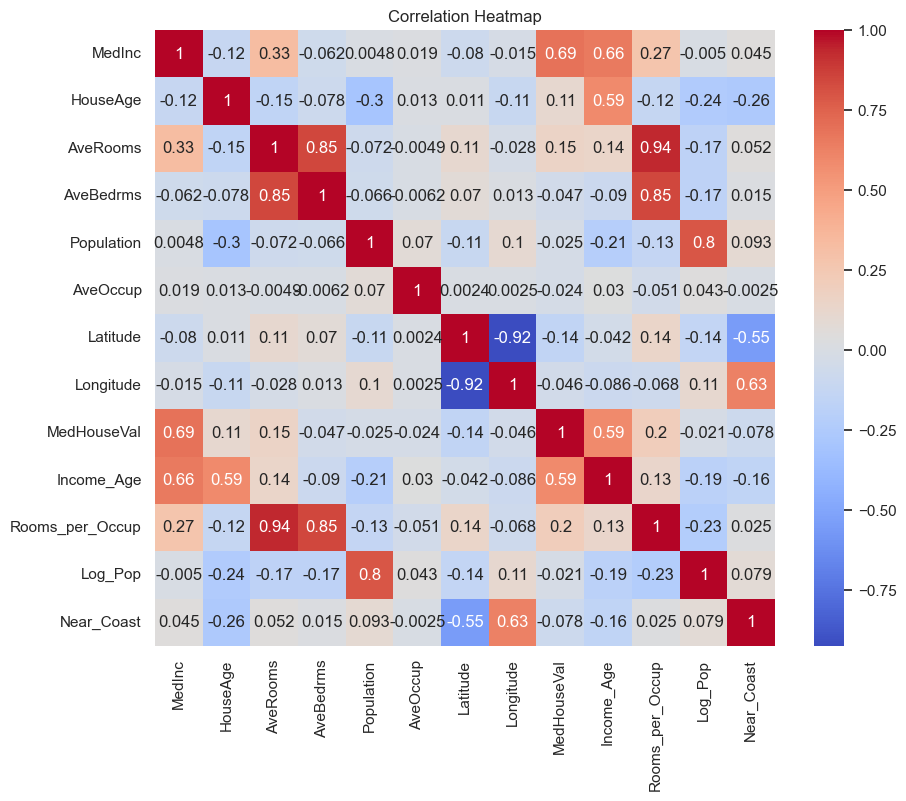

In [12]:
# Correlations
plt.figure(figsize=(10, 8))
sns.heatmap(df.corr(), annot=True, cmap='coolwarm')
plt.title("Correlation Heatmap")
plt.show()

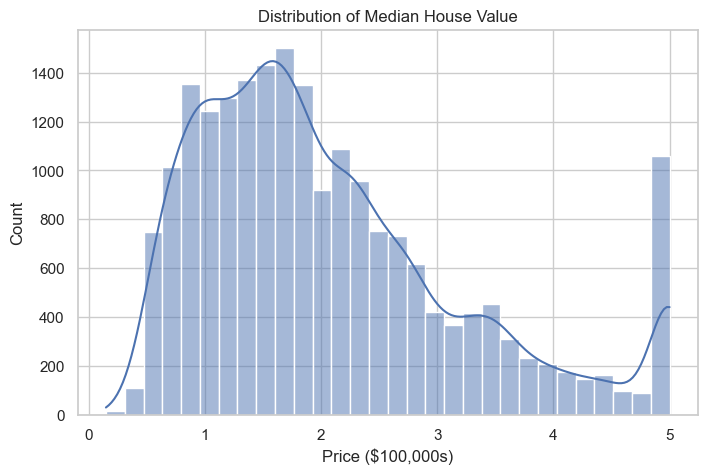

In [13]:
# Distribution of the target variable (price)
plt.figure(figsize=(8, 5))
sns.histplot(df["MedHouseVal"], kde=True, bins=30)
plt.title("Distribution of Median House Value")
plt.xlabel("Price ($100,000s)")
plt.show()

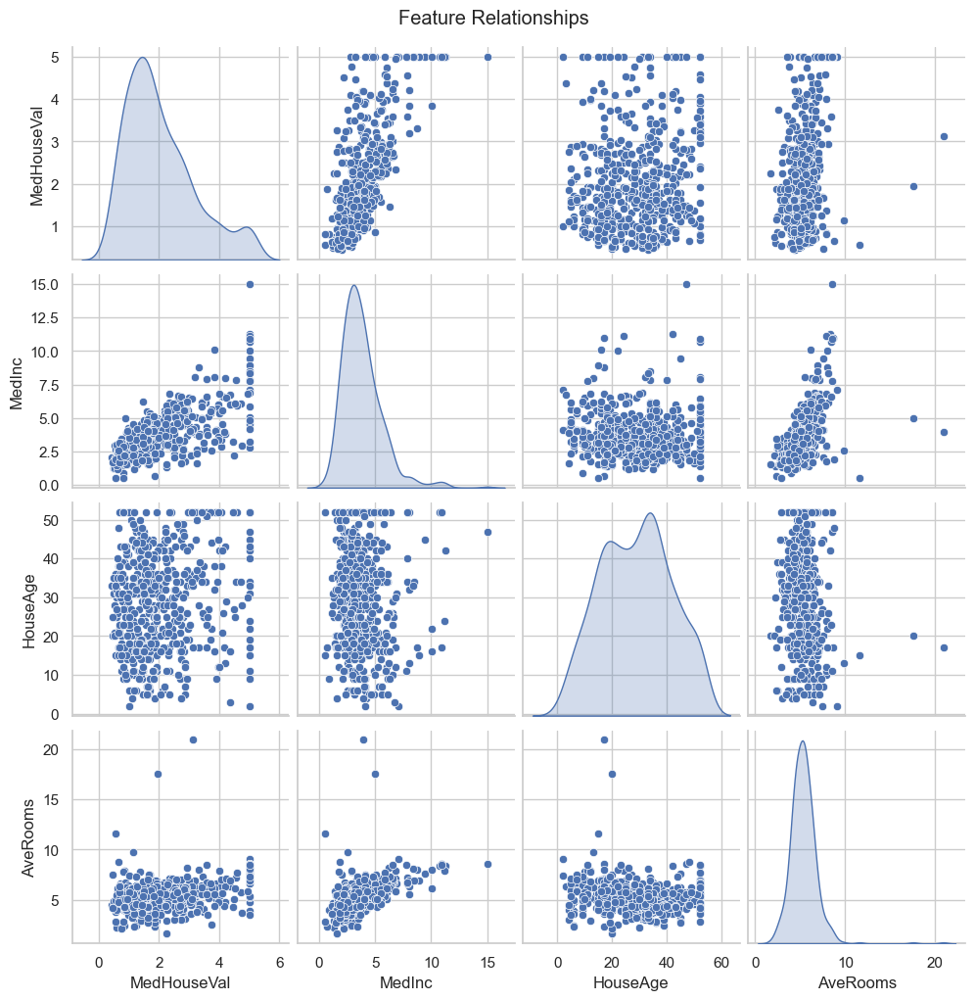

In [14]:
# Pairplot Sample (Quick look)
sample_df = df.sample(500)
sns.pairplot(sample_df[['MedHouseVal', 'MedInc', 'HouseAge', 'AveRooms']], diag_kind='kde')
plt.suptitle("Feature Relationships", y=1.02)
plt.show()

In [15]:
# Prepare features and target
X = df.drop("MedHouseVal", axis=1)
y = df["MedHouseVal"]

print("Feature columns:", list(X.columns))
print("Target column  : MedHouseVal")

Feature columns: ['MedInc', 'HouseAge', 'AveRooms', 'AveBedrms', 'Population', 'AveOccup', 'Latitude', 'Longitude', 'Income_Age', 'Rooms_per_Occup', 'Log_Pop', 'Near_Coast']
Target column  : MedHouseVal


In [16]:
# Scale features first
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

In [17]:
# Feature selection with SelectKBest
print("Performing SelectKBest feature selection:")
kbest = SelectKBest(score_func=f_regression, k=9)
X_kbest = kbest.fit_transform(X_scaled, y)
selected_features = X.columns[kbest.get_support()]
X = df[selected_features]

print(f"Top 9 selected features by SelectKBest: {list(selected_features)}")

Performing SelectKBest feature selection:
Top 9 selected features by SelectKBest: ['MedInc', 'HouseAge', 'AveRooms', 'AveBedrms', 'Latitude', 'Longitude', 'Income_Age', 'Rooms_per_Occup', 'Near_Coast']


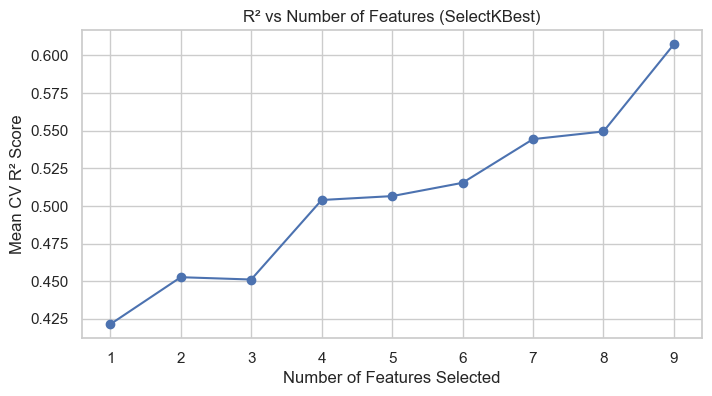

In [18]:
# Visualize R² score vs number of selected features
r2_scores = []
for k in range(1, X.shape[1] + 1):
    selector = SelectKBest(score_func=f_regression, k=k)
    X_k = selector.fit_transform(X_scaled, y)
    score = cross_val_score(LinearRegression(), X_k, y, cv=5, scoring="r2").mean()
    r2_scores.append(score)

plt.figure(figsize=(8,4))
plt.plot(range(1, X.shape[1]+1), r2_scores, marker='o')
plt.xlabel("Number of Features Selected")
plt.ylabel("Mean CV R² Score")
plt.title("R² vs Number of Features (SelectKBest)")
plt.grid(True)
plt.show()

In [19]:
# Train/Test Split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Scale based on train data only
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

print("Dataset split completed:")
print(f"- Train size: {X_train.shape[0]}")
print(f"- Test size: {X_test.shape[0]}")

Dataset split completed:
- Train size: 16512
- Test size: 4128


In [20]:
# Define Models
models = {
    "Linear Regression"   : LinearRegression(),
    "Ridge Regression"    : Ridge(alpha=1.0),
    "Lasso Regression"    : Lasso(alpha=0.1),
    "ElasticNet"          : ElasticNet(alpha=0.1, l1_ratio=0.5),
    "Random Forest"       : RandomForestRegressor(n_estimators=150, random_state=42),
    "Gradient Boosting"   : GradientBoostingRegressor(n_estimators=100, random_state=42),
    "Extra Trees"         : ExtraTreesRegressor(n_estimators=100, random_state=42),
    "AdaBoost"            : AdaBoostRegressor(n_estimators=100, random_state=42),
    "HistGradientBoosting": HistGradientBoostingRegressor(random_state=42),
    "Decision Tree"       : DecisionTreeRegressor(random_state=42),
    "Bayesian Ridge"      : BayesianRidge(),
    "Huber Regressor"     : HuberRegressor(),
    "KNN Regressor"       : KNeighborsRegressor(n_neighbors=5),
    "SVR (RBF Kernel)"    : SVR(kernel='rbf'),
    "XGBoost"             : XGBRegressor(n_estimators=100, random_state=42, verbosity=0),
    "LightGBM"            : LGBMRegressor(n_estimators=100, random_state=42, verbose=-1),
    "CatBoost"            : CatBoostRegressor(verbose=0, random_state=42),
    "MLP Regressor"       : MLPRegressor(hidden_layer_sizes=(64, 32), max_iter=500, random_state=42)
}

# Add Stacking
models["Stacking RF+GB+XGB"] = StackingRegressor(
    estimators=[
        ("rf", RandomForestRegressor(n_estimators=50, random_state=42)),
        ("gb", GradientBoostingRegressor(n_estimators=50, random_state=42)),
        ("xgb", XGBRegressor(n_estimators=50, random_state=42, verbosity=0))
    ],
    final_estimator=Ridge(),
    passthrough=True,
    cv=5,
    n_jobs=-1
)

models["Stacking Linear+Tree+Cat"] = StackingRegressor(
    estimators=[
        ("lasso", Lasso(alpha=0.1)),
        ("dt", DecisionTreeRegressor(max_depth=10)),
        ("knn", KNeighborsRegressor(n_neighbors=7)),
        ("cat", CatBoostRegressor(verbose=0, random_state=42))
    ],
    final_estimator=LGBMRegressor(n_estimators=50, random_state=42, verbose=-1),
    passthrough=True,
    cv=5,
    n_jobs=-1
)

models["Stacking LR+DT+Cat"] = StackingRegressor(
    estimators=[
        ("lr", LinearRegression()),
        ("dt", DecisionTreeRegressor(max_depth=10, random_state=42)),
        ("cat", CatBoostRegressor(verbose=0, random_state=42))
    ],
    final_estimator=LGBMRegressor(n_estimators=50, random_state=42, verbose=-1),
    passthrough=True,
    cv=5,
    n_jobs=-1
)

models["Stacking LR+SVR+MLP"] = StackingRegressor(
    estimators=[
        ("lr", LinearRegression()),
        ("svr", SVR(kernel='rbf')),
        ("mlp", MLPRegressor(hidden_layer_sizes=(32,), max_iter=300, random_state=42))
    ],
    final_estimator=GradientBoostingRegressor(n_estimators=100, random_state=42),
    passthrough=True,
    cv=5,
    n_jobs=-1
)

In [21]:
# Train & Evaluate with CV for best model
cv = KFold(n_splits=5, shuffle=True, random_state=42)
results = {}

for name, model in models.items():
    print(f"\nTraining {name}:")
    scores = cross_val_score(model, X_train_scaled, y_train, cv=cv, scoring='r2', n_jobs=-1)
    
    model.fit(X_train_scaled, y_train)
    y_pred = model.predict(X_test_scaled)

    mae = mean_absolute_error(y_test, y_pred)
    mse = mean_squared_error(y_test, y_pred)
    r2 = r2_score(y_test, y_pred)

    results[name] = {"MAE": mae, "MSE": mse, "RMSE": np.sqrt(mse), "R2": r2, "CV_R2_Mean": scores.mean()}
    print(f"MAE   : {mae:.4f}")
    print(f"MSE   : {mse:.4f}")
    print(f"RMSE  : {np.sqrt(mse):.4f}")
    print(f"R²    : {r2:.4f}")
    print(f"CV R² : {scores.mean():.4f}")


Training Linear Regression:
MAE   : 0.4933
MSE   : 0.4668
RMSE  : 0.6832
R²    : 0.6438
CV R² : 0.6551

Training Ridge Regression:
MAE   : 0.4933
MSE   : 0.4668
RMSE  : 0.6832
R²    : 0.6438
CV R² : 0.6551

Training Lasso Regression:
MAE   : 0.6192
MSE   : 0.6749
RMSE  : 0.8215
R²    : 0.4849
CV R² : 0.5025

Training ElasticNet:
MAE   : 0.5891
MSE   : 0.6266
RMSE  : 0.7916
R²    : 0.5218
CV R² : 0.5404

Training Random Forest:
MAE   : 0.3281
MSE   : 0.2539
RMSE  : 0.5039
R²    : 0.8062
CV R² : 0.8033

Training Gradient Boosting:
MAE   : 0.3708
MSE   : 0.2976
RMSE  : 0.5455
R²    : 0.7729
CV R² : 0.7836

Training Extra Trees:
MAE   : 0.3244
MSE   : 0.2503
RMSE  : 0.5003
R²    : 0.8090
CV R² : 0.8073

Training AdaBoost:
MAE   : 0.7020
MSE   : 0.6875
RMSE  : 0.8291
R²    : 0.4754
CV R² : 0.4577

Training HistGradientBoosting:
MAE   : 0.3091
MSE   : 0.2157
RMSE  : 0.4644
R²    : 0.8354
CV R² : 0.8336

Training Decision Tree:
MAE   : 0.4420
MSE   : 0.4805
RMSE  : 0.6932
R²    : 0.6333
CV R

In [22]:
# Results Comparison sorted results by R² score
results_df = pd.DataFrame(results).T.sort_values(by="R2", ascending=False)
results_df.style.background_gradient(axis=0, cmap="YlGnBu")

,MAE,MSE,RMSE,R2,CV_R2_Mean
Stacking Linear+Tree+Cat,0.287278,0.195901,0.442607,0.850504,0.846779
Stacking LR+DT+Cat,0.287245,0.196286,0.443042,0.850210,0.846648
CatBoost,0.291381,0.198351,0.445366,0.848634,0.847055
LightGBM,0.308192,0.214460,0.463099,0.836341,0.835376
HistGradientBoosting,0.309053,0.215702,0.464438,0.835393,0.833585
Stacking RF+GB+XGB,0.306888,0.219222,0.468212,0.832707,0.829920
XGBoost,0.307447,0.220494,0.469567,0.831737,0.828044
MLP Regressor,0.334001,0.245901,0.495884,0.812348,0.801044
Extra Trees,0.324440,0.250274,0.500274,0.809011,0.807320
Random Forest,0.328118,0.253944,0.503929,0.806210,0.803272


Best model: Stacking Linear+Tree+Cat


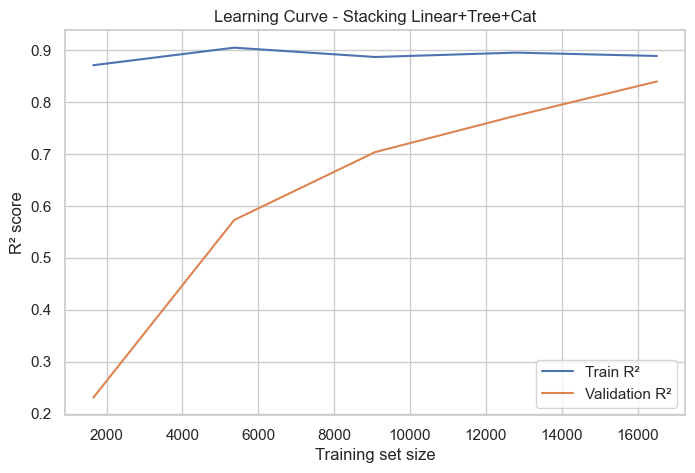

In [23]:
# Learning Curve (Best Model)
best_model_name = results_df.index[0]
best_model = models[best_model_name]
print(f"Best model: {best_model_name}")

train_sizes, train_scores, test_scores = learning_curve(
    best_model, scaler.transform(X), y,
    cv=cv, scoring='r2', n_jobs=-1,
    train_sizes=np.linspace(0.1, 1.0, 5), random_state=42
)

plt.figure(figsize=(8,5))
plt.plot(train_sizes, train_scores.mean(axis=1), label='Train R²')
plt.plot(train_sizes, test_scores.mean(axis=1), label='Validation R²')
plt.xlabel('Training set size')
plt.ylabel('R² score')
plt.title(f'Learning Curve - {best_model_name}')
plt.legend()
plt.grid(True)
plt.show()

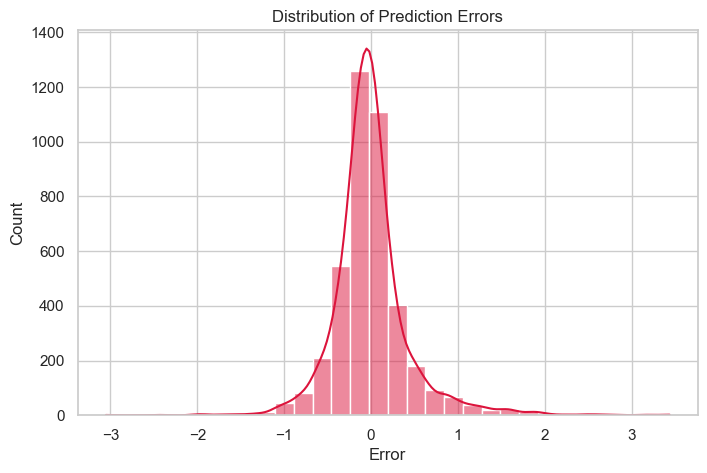

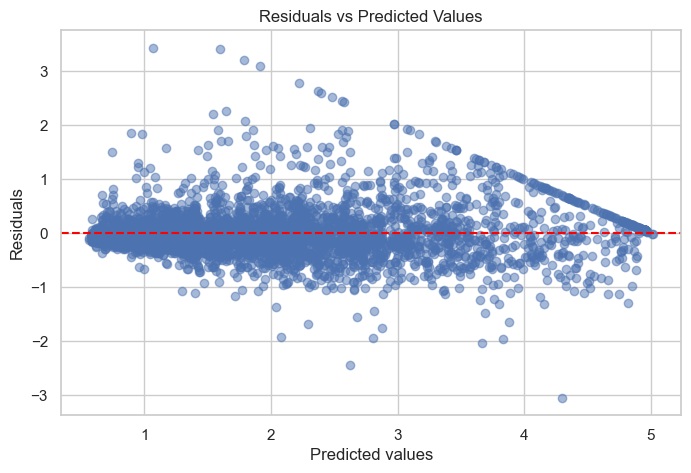

In [24]:
# Error Analysis
y_pred_best = best_model.predict(X_test_scaled)
errors = y_test - y_pred_best

plt.figure(figsize=(8,5))
sns.histplot(errors, bins=30, kde=True, color="crimson")
plt.title("Distribution of Prediction Errors")
plt.xlabel("Error")
plt.show()

plt.figure(figsize=(8,5))
plt.scatter(y_pred_best, errors, alpha=0.5)
plt.axhline(0, linestyle='--', color='red')
plt.xlabel("Predicted values")
plt.ylabel("Residuals")
plt.title("Residuals vs Predicted Values")
plt.show()

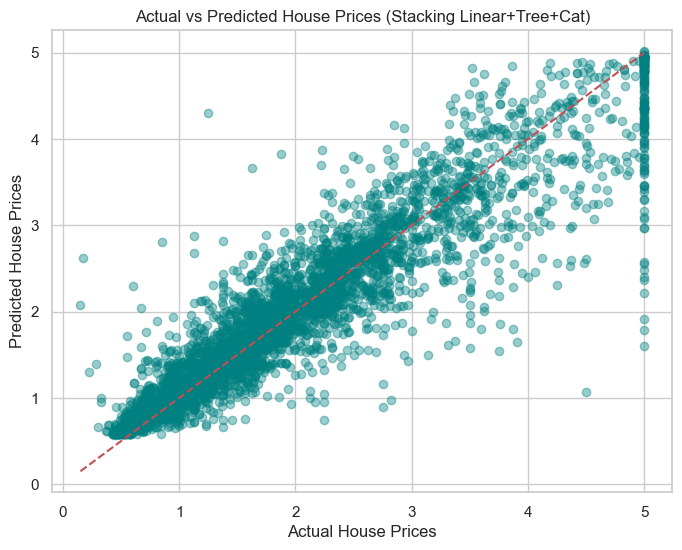

In [25]:
# Best Model Prediction Plot
plt.figure(figsize=(8,6))
plt.scatter(y_test, y_pred_best, alpha=0.4, color='teal')
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'r--')
plt.xlabel("Actual House Prices")
plt.ylabel("Predicted House Prices")
plt.title(f"Actual vs Predicted House Prices ({best_model_name})")
plt.show()

In [26]:
# Feature Importance
if hasattr(best_model, "feature_importances_"):
    importances = best_model.feature_importances_
    features = X.columns
    
    imp_df = pd.DataFrame({"Feature": features, "Importance": importances})
    imp_df = imp_df.sort_values(by="Importance", ascending=True)
    
    plt.figure(figsize=(10,6))
    sns.barplot(x="Importance", y="Feature", data=imp_df, palette="viridis")
    plt.title(f"Feature Importances ({best_model_name})")
    plt.show()

In [28]:
# Predict on New Sample
sample = pd.DataFrame({
    "MedInc": [6.5],
    "HouseAge": [25],
    "AveRooms": [5],
    "AveBedrms": [1.2],
    "Population": [1000],
    "AveOccup": [3],
    "Latitude": [34],
    "Longitude": [-118]
})

# Feature engineering for sample
sample["Income_Age"] = sample["MedInc"] * sample["HouseAge"]
sample["Rooms_per_Occup"] = sample["AveRooms"] / (sample["AveOccup"] + 1)
sample["Log_Pop"] = np.log(sample["Population"] + 1)
sample["Near_Coast"] = (sample["Longitude"] > -118).astype(int)

# Feature Selection
sample = sample[selected_features]

# Scale the sample using the loaded scaler
sample_scaled = scaler.transform(sample)

# Predict using best model
sample_pred = best_model.predict(sample_scaled)
print(f"Predicted House Value for Sample: ${sample_pred[0]*100000:.2f}")

Predicted House Value for Sample: $271893.57


In [29]:
# Export Best Model
now = datetime.datetime.now().strftime("%Y_%m_%d")
filename = f"best_model_{best_model_name.replace(' ', '_')}_{now}.pkl"
with open(filename, 'wb') as f:
    pickle.dump((scaler, best_model), f)
print(f"Best model saved as: {filename}")

Best model saved as: best_model_Stacking_Linear+Tree+Cat_2025_07_20.pkl
